#**Retrasos en vuelos**
**Sobre la bbdd:**
* Estados Unidos - Enero 2023



**Objetivos:**
*   Indentificar la ciudad de origen con mayor retraso
*   Indentificar la ciudad de destino con mayor retraso
*   Identificar la principal causa de retraso en las ciudades

#**Importar datos**

##**Tabla Flights**

In [1]:
from google.colab import files

In [2]:
#Lee el archivo CSV con pandas
import pandas as pd

dflights = pd.read_csv('flights_202301.csv')

# Verificar que el archivo se subió correctamente
dflights.head()

,FL_DATE,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,...,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY
0,2023-01-02,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,757.0,...,25.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,2
1,2023-01-03,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,755.0,...,37.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,3
2,2023-01-04,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,755.0,...,28.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,4
3,2023-01-05,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,754.0,...,38.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,5
4,2023-01-06,9E,20363,4628,BDL,"Hartford, CT",LGA,"New York, NY",800,759.0,...,28.0,101,NaN,NaN,NaN,NaN,NaN,2023,1,6


In [3]:
# Para ver la información general sobre las columnas y tipos de dato
dflights.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 538837 entries, 0 to 538836
Data columns (total 33 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   FL_DATE                  538837 non-null  object 
 1   AIRLINE_CODE             538837 non-null  object 
 2   DOT_CODE                 538837 non-null  int64  
 3   FL_NUMBER                538837 non-null  int64  
 4   ORIGIN                   538837 non-null  object 
 5   ORIGIN_CITY              538837 non-null  object 
 6   DEST                     538837 non-null  object 
 7   DEST_CITY                538837 non-null  object 
 8   CRS_DEP_TIME             538837 non-null  int64  
 9   DEP_TIME                 528859 non-null  float64
 10  DEP_DELAY                528855 non-null  float64
 11  TAXI_OUT                 528640 non-null  float64
 12  WHEELS_OFF               528640 non-null  float64
 13  WHEELS_ON                528318 non-null  float64
 14  TAXI

## **Tabla AIRLINES y DOT CODE**

In [4]:
from google.colab import files
import pandas as pd

# Sube AIRLINES
airlines = pd.read_csv('AIRLINE_CODE_DICTIONARY.csv')

# Sube DOT CODE
airoperator = pd.read_excel('DOT_CODE_DICTIONARY.xlsx')

#**Identificar y manejar nulos**



##**Tabla Flights**

In [5]:
# Cuenta el número de valores nulos por columna
valores_nulos = dflights.isnull().sum()

# Muestra solo las columnas que tienen valores nulos
print(valores_nulos[valores_nulos > 0])

DEP_TIME                     9978
DEP_DELAY                    9982
TAXI_OUT                    10197
WHEELS_OFF                  10197
WHEELS_ON                   10519
TAXI_IN                     10519
ARR_TIME                    10519
ARR_DELAY                   11640
CRS_ELAPSED_TIME                1
ELAPSED_TIME                11640
AIR_TIME                    11640
DELAY_DUE_CARRIER          422124
DELAY_DUE_WEATHER          422124
DELAY_DUE_NAS              422124
DELAY_DUE_SECURITY         422124
DELAY_DUE_LATE_AIRCRAFT    422124
dtype: int64


In [6]:
# Imputar con CERO variables asociadas a vuelos cancelados o desviados
columnas_a_imputar_con_cero = [
    'DEP_TIME', 'DEP_DELAY', 'TAXI_OUT', 'WHEELS_OFF', 'WHEELS_ON',
    'TAXI_IN', 'ARR_TIME', 'ARR_DELAY', 'ELAPSED_TIME', 'AIR_TIME'
]

for col in columnas_a_imputar_con_cero:
    dflights[col] = dflights[col].fillna(0)

In [7]:
# Eliminar tiempo de vuelo nulo, no afecta análisis
dflights.dropna(subset=['CRS_ELAPSED_TIME'], inplace=True)

In [8]:
# Imputar con CERO variables asociadas a retrasos en vuelos
columnas_causa_retraso = [
    'DELAY_DUE_CARRIER',
    'DELAY_DUE_WEATHER',
    'DELAY_DUE_NAS',
    'DELAY_DUE_SECURITY',
    'DELAY_DUE_LATE_AIRCRAFT'
]

dflights[columnas_causa_retraso] = dflights[columnas_causa_retraso].fillna(0)

In [9]:
# Vuelve a contar el número de valores nulos por columna
valores_nulos_despues = dflights.isnull().sum()

print(valores_nulos_despues[valores_nulos_despues > 0])

Series([], dtype: int64)


##**Tabla AIRLINES y DOT CODE**

In [10]:
# Nulos en base airlines
nulo_airlines = airlines.isnull().sum()
print(nulo_airlines[nulo_airlines > 0])

# Nulos en base air operator
nulo_airoperator = airoperator.isnull().sum()
print(nulo_airoperator[nulo_airoperator > 0])

Code    1
dtype: int64
Description    4
dtype: int64


In [11]:
#Eliminar nulos en base air operator
airoperator.dropna (subset=['Description'],inplace=True)

In [12]:
airlines.info()
airoperator.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1729 entries, 0 to 1728
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Code         1728 non-null   object
 1   Description  1729 non-null   object
dtypes: object(2)
memory usage: 27.1+ KB
<class 'pandas.core.frame.DataFrame'>
Index: 1733 entries, 0 to 1732
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Code         1733 non-null   int64 
 1   Description  1733 non-null   object
dtypes: int64(1), object(1)
memory usage: 40.6+ KB


#**Identificar y manejar duplicados**

##**Tabla Flights**

In [13]:
columnas_clave = [
    'FL_DATE',
    'DOT_CODE',
    'FL_NUMBER',
    'ORIGIN',
    'DEST'
]

duplicados = dflights.duplicated(subset=columnas_clave, keep=False)

conteo_de_duplicados = duplicados.sum()

print(f"Número de filas duplicadas: {conteo_de_duplicados}")

Número de filas duplicadas: 0


##**Tabla AIRLINES y DOT CODE**

In [14]:
# Identificar duplicados en Airlines y Airoperator

filtro_duplicados_airlines = airlines.duplicated(subset=['Code'], keep=False)
# Muestra las filas duplicadas en el DataFrame airlines
print("Duplicados en Airlines:")
display(airlines[filtro_duplicados_airlines])

filtro_duplicados_airoperator = airoperator.duplicated(subset=['Code'], keep=False)
# Muestra las filas duplicadas en el DataFrame airoperator
print("\nDuplicados en Airoperator:")
display(airoperator[filtro_duplicados_airoperator])

Duplicados en Airlines:


,Code,Description



Duplicados en Airoperator:


,Code,Description
1725,22120,Sparfell Malta Ltd: QFX
1726,22121,Haute Aviation: HUQ
1727,22122,AXIS Aviation Switzerland AG: XQQ
1728,22123,Western Air Ltd: WU
1729,22120,SPARFELL MALTA LTD: QFX
1730,22121,HAUTE AVIATION: HUQ
1731,22122,AXIS AVIATION SWITZERLAND AG: XQQ
1732,22123,WESTERN AIR LTD: WU


In [15]:
# Elimina los duplicados de la tabla air operator basándote en la columna 'Code'
airoperator_limpio = airoperator.drop_duplicates(subset=['Code'], keep='first').copy()

# Muestra el nuevo número de filas para verificar que se eliminaron los duplicados
print(f"El número de filas después de eliminar duplicados es: {len(airoperator_limpio)}")

El número de filas después de eliminar duplicados es: 1729


#**Filtrar datos fuera del alcance**

##**Filtra vuelos cancelados**

In [16]:
# Contar el número de vuelos cancelados y no cancelados
print("Vuelos Cancelados:")
print(dflights['CANCELLED'].value_counts())

Vuelos Cancelados:
CANCELLED
0    528542
1     10294
Name: count, dtype: int64


In [17]:
# Filtra los vuelos que no fueron cancelados
dflights_realizados = dflights[dflights['CANCELLED'] == 0]

# Revisión de la cantidad de vuelos para confirmar que se eliminaron
print("Distribución de la columna 'CANCELLED' después de la limpieza:")
print(dflights_realizados['CANCELLED'].value_counts())

Distribución de la columna 'CANCELLED' después de la limpieza:
CANCELLED
0    528542
Name: count, dtype: int64


##**Filtra vuelos desviados**

In [18]:
# Contar el número de vuelos desviados y no desviados
print("\nVuelos Desviados:")
print(dflights_realizados['DIVERTED'].value_counts())


Vuelos Desviados:
DIVERTED
0    527197
1      1345
Name: count, dtype: int64


In [19]:
# Filtra los vuelos desviados (DIVERTED == 0)
dflights_efectivos = dflights_realizados[dflights_realizados['DIVERTED'] == 0].copy()

In [20]:
# Valida que solo queden vuelos no desviados
print("Distribución de la columna 'DIVERTED' después de la limpieza:")
dflights_efectivos['DIVERTED'].value_counts()

Distribución de la columna 'DIVERTED' después de la limpieza:


,count
DIVERTED,
0,527197


#**Tratar valores atípicos**

In [21]:
import numpy as np

# Selecciona las columnas de tipo 'object' y 'int64'
columnas_a_revisar = dflights_efectivos.select_dtypes(include=['object', np.int64]).columns

# Itera a través de las columnas seleccionadas
for columna in columnas_a_revisar:
   print(f"--- Frecuencia de la columna: '{columna}' ---")
   print(dflights_efectivos[columna].value_counts())
   print("\n")

--- Frecuencia de la columna: 'FL_DATE' ---
FL_DATE
2023-01-20    18429
2023-01-26    18395
2023-01-27    18394
2023-01-13    18320
2023-01-19    18295
2023-01-12    18191
2023-01-09    18072
2023-01-16    17991
2023-01-22    17949
2023-01-23    17918
2023-01-29    17881
2023-01-08    17681
2023-01-02    17100
2023-01-30    17084
2023-01-24    16965
2023-01-06    16964
2023-01-17    16895
2023-01-15    16881
2023-01-03    16862
2023-01-10    16857
2023-01-18    16833
2023-01-25    16824
2023-01-05    16773
2023-01-04    16088
2023-01-11    15999
2023-01-07    15518
2023-01-01    15470
2023-01-31    15339
2023-01-21    15309
2023-01-28    15149
2023-01-14    14771
Name: count, dtype: int64


--- Frecuencia de la columna: 'AIRLINE_CODE' ---
AIRLINE_CODE
WN    108999
DL     74419
AA     73454
UA     56102
OO     48378
YX     24049
B6     22978
NK     21348
AS     19421
MQ     18325
9E     16637
OH     15165
F9     12828
G4      8478
HA      6616
Name: count, dtype: int64


--- Frecuencia 

In [22]:
# Muestra estadísticas descriptivas para todas las variables numéricas
dflights_efectivos.describe().T

,count,mean,std,min,25%,50%,75%,max
DOT_CODE,527197.0,19945.195324,373.149129,19393.0,19790.0,19930.0,20363.0,20452.0
FL_NUMBER,527197.0,2196.049987,1543.193497,1.0,970.0,1903.0,3035.0,9887.0
CRS_DEP_TIME,527197.0,1327.052633,489.917114,5.0,910.0,1319.0,1731.0,2359.0
DEP_TIME,527197.0,1334.612375,502.362715,1.0,917.0,1327.0,1743.0,2400.0
DEP_DELAY,527197.0,12.840955,54.958138,-52.0,-6.0,-2.0,10.0,3024.0
TAXI_OUT,527197.0,18.325522,10.613087,1.0,12.0,15.0,21.0,222.0
WHEELS_OFF,527197.0,1358.653710,503.843352,1.0,934.0,1341.0,1757.0,2400.0
WHEELS_ON,527197.0,1471.856084,532.109596,1.0,1054.0,1509.0,1917.0,2400.0
TAXI_IN,527197.0,8.034778,6.406388,1.0,4.0,6.0,9.0,173.0
CRS_ARR_TIME,527197.0,1497.235022,515.036776,1.0,1109.0,1520.0,1927.0,2359.0


In [23]:
# Muestra los registros que tienen un retraso de salida de más de 48 horas
dflights_efectivos[dflights_efectivos['DEP_DELAY'] > (48*60)]

,FL_DATE,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,...,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY
54466,2023-01-24,AA,19805,1975,SLC,"Salt Lake City, UT",PHX,"Phoenix, AZ",645,909.0,...,70.0,507,3024.0,0.0,39.0,0.0,0.0,2023,1,24


In [24]:
# Crea una nueva versión de la bbdd filtrando los retrasos extremos >48 hrs
dflights_limpio = dflights_efectivos[
    (dflights_efectivos['DEP_DELAY'] < (48*60)) |
    (dflights_efectivos['ARR_DELAY'] < (48*60))
].copy()

#**Verificar y cambiar tipos de datos**

In [25]:
# Convierte la columna de fecha
dflights_limpio['FL_DATE'] = pd.to_datetime(dflights_limpio['FL_DATE'])

# Convierte las columnas numéricas a int64
columnas_a_entero = ['CRS_DEP_TIME', 'CRS_ARR_TIME', 'DISTANCE']
for columna in columnas_a_entero:
    dflights_limpio[columna] = dflights_limpio[columna].astype('int64')

# Verificar que los cambios se aplicaron correctamente
dflights_limpio.info()

<class 'pandas.core.frame.DataFrame'>
Index: 527196 entries, 0 to 538836
Data columns (total 33 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   FL_DATE                  527196 non-null  datetime64[ns]
 1   AIRLINE_CODE             527196 non-null  object        
 2   DOT_CODE                 527196 non-null  int64         
 3   FL_NUMBER                527196 non-null  int64         
 4   ORIGIN                   527196 non-null  object        
 5   ORIGIN_CITY              527196 non-null  object        
 6   DEST                     527196 non-null  object        
 7   DEST_CITY                527196 non-null  object        
 8   CRS_DEP_TIME             527196 non-null  int64         
 9   DEP_TIME                 527196 non-null  float64       
 10  DEP_DELAY                527196 non-null  float64       
 11  TAXI_OUT                 527196 non-null  float64       
 12  WHEELS_OFF           

#**Unir tablas**

In [26]:
# Unir la tabla principal de vuelos con airlines
df_final = pd.merge(dflights_limpio,
                    airlines,
                    left_on='AIRLINE_CODE',
                    right_on='Code',
                    how='left')

# Ver las primeras filas de la tabla combinada para confirmar que se agregó la columna 'Description'
print(df_final.head())

     FL_DATE AIRLINE_CODE  DOT_CODE  FL_NUMBER ORIGIN   ORIGIN_CITY DEST  \
0 2023-01-02           9E     20363       4628    BDL  Hartford, CT  LGA   
1 2023-01-03           9E     20363       4628    BDL  Hartford, CT  LGA   
2 2023-01-04           9E     20363       4628    BDL  Hartford, CT  LGA   
3 2023-01-05           9E     20363       4628    BDL  Hartford, CT  LGA   
4 2023-01-06           9E     20363       4628    BDL  Hartford, CT  LGA   

      DEST_CITY  CRS_DEP_TIME  DEP_TIME  ...  DELAY_DUE_CARRIER  \
0  New York, NY           800     757.0  ...                0.0   
1  New York, NY           800     755.0  ...                0.0   
2  New York, NY           800     755.0  ...                0.0   
3  New York, NY           800     754.0  ...                0.0   
4  New York, NY           800     759.0  ...                0.0   

   DELAY_DUE_WEATHER  DELAY_DUE_NAS  DELAY_DUE_SECURITY  \
0                0.0            0.0                 0.0   
1                0.0  

In [27]:
# Unir la tabla combinada con air operator
df_final = pd.merge(df_final,
                    airoperator_limpio,
                    left_on='DOT_CODE',
                    right_on='Code',
                    how='left',
                    suffixes=('_aerolinea', '_operador'))

# Revisa la información de la nueva tabla combinada
print(df_final.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 527196 entries, 0 to 527195
Data columns (total 37 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   FL_DATE                  527196 non-null  datetime64[ns]
 1   AIRLINE_CODE             527196 non-null  object        
 2   DOT_CODE                 527196 non-null  int64         
 3   FL_NUMBER                527196 non-null  int64         
 4   ORIGIN                   527196 non-null  object        
 5   ORIGIN_CITY              527196 non-null  object        
 6   DEST                     527196 non-null  object        
 7   DEST_CITY                527196 non-null  object        
 8   CRS_DEP_TIME             527196 non-null  int64         
 9   DEP_TIME                 527196 non-null  float64       
 10  DEP_DELAY                527196 non-null  float64       
 11  TAXI_OUT                 527196 non-null  float64       
 12  WHEELS_OFF      

In [28]:
# Elimina las columnas 'Code_aerolinea' y 'Code_operador' que son redundantes
df_final = df_final.drop(columns=['Code_aerolinea', 'Code_operador'])

# Muestra la información de la tabla final para confirmar que las columnas se eliminaron
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 527196 entries, 0 to 527195
Data columns (total 35 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   FL_DATE                  527196 non-null  datetime64[ns]
 1   AIRLINE_CODE             527196 non-null  object        
 2   DOT_CODE                 527196 non-null  int64         
 3   FL_NUMBER                527196 non-null  int64         
 4   ORIGIN                   527196 non-null  object        
 5   ORIGIN_CITY              527196 non-null  object        
 6   DEST                     527196 non-null  object        
 7   DEST_CITY                527196 non-null  object        
 8   CRS_DEP_TIME             527196 non-null  int64         
 9   DEP_TIME                 527196 non-null  float64       
 10  DEP_DELAY                527196 non-null  float64       
 11  TAXI_OUT                 527196 non-null  float64       
 12  WHEELS_OFF      

##**Filtra vuelos en tiempo**

In [29]:
df_final = df_final[(df_final['DEP_DELAY'] > 0) | (df_final['ARR_DELAY'] > 0)]

# Verificar valor mínimo
print("Valores mínimos después del filtro:")
print(df_final[['DEP_DELAY', 'ARR_DELAY']].min())

# Contar cantidad de filas
print("\nCantidad de vuelos con retraso:")
print(df_final.shape[0])

Valores mínimos después del filtro:
DEP_DELAY   -28.0
ARR_DELAY   -74.0
dtype: float64

Cantidad de vuelos con retraso:
256522


In [30]:
# Agregar columna de delay dep y delay arr
df_final['DIC_DEPDELAY']= (df_final['DEP_DELAY']>0).astype(int)
df_final['DIC_ARRDELAY']= (df_final['ARR_DELAY']>0).astype(int)

# Verificar que las columnas se crearon correctamente
df_final.head()

,FL_DATE,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,...,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,FL_YEAR,FL_MONTH,FL_DAY,Description_aerolinea,Description_operador,DIC_DEPDELAY,DIC_ARRDELAY
10,2023-01-10,9E,20363,4629,LGA,"New York, NY",BGM,"Binghamton, NY",2129,2114.0,...,0.0,0.0,0.0,2023,1,10,Endeavor Air Inc.,Endeavor Air Inc.: 9E,0,1
11,2023-01-11,9E,20363,4629,LGA,"New York, NY",BGM,"Binghamton, NY",2129,2204.0,...,26.0,0.0,35.0,2023,1,11,Endeavor Air Inc.,Endeavor Air Inc.: 9E,1,1
12,2023-01-12,9E,20363,4629,LGA,"New York, NY",BGM,"Binghamton, NY",2129,2341.0,...,0.0,0.0,82.0,2023,1,12,Endeavor Air Inc.,Endeavor Air Inc.: 9E,1,1
13,2023-01-13,9E,20363,4629,LGA,"New York, NY",BGM,"Binghamton, NY",2129,2124.0,...,34.0,0.0,0.0,2023,1,13,Endeavor Air Inc.,Endeavor Air Inc.: 9E,0,1
14,2023-01-15,9E,20363,4629,LGA,"New York, NY",BGM,"Binghamton, NY",2129,2134.0,...,0.0,0.0,0.0,2023,1,15,Endeavor Air Inc.,Endeavor Air Inc.: 9E,1,1


#**Análisis variables**

##**Nueva variable "Rutas"**

In [31]:
# Crear "ruta" como nueva variable
df_final["Rutas"]=df_final.ORIGIN_CITY + " - " + df_final.DEST_CITY

In [32]:
df_final.Rutas.describe()

,Rutas
count,256522
unique,5068
top,"Chicago, IL - New York, NY"
freq,723


###**Gráfico: 20 Rutas con mayor frecuencia de vuelos con retraso**

/tmp/ipython-input-3368525124.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  grafico_barras = sns.barplot(x=top_20_rutas.index, y=top_20_rutas.values, palette='viridis')


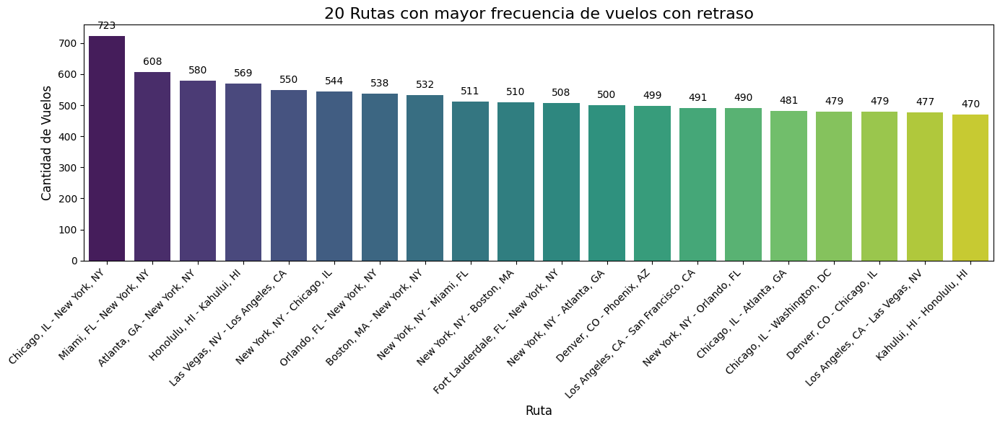

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns

# Cuenta las 20 rutas más frecuentes
top_20_rutas = df_final['Rutas'].value_counts().head(20)

# Crea el gráfico de barras con Seaborn
plt.figure(figsize=(14, 6))
grafico_barras = sns.barplot(x=top_20_rutas.index, y=top_20_rutas.values, palette='viridis')
plt.title('20 Rutas con mayor frecuencia de vuelos con retraso', fontsize=16)
plt.xlabel('Ruta', fontsize=12)
plt.ylabel('Cantidad de Vuelos', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Añade etiquetas a cada barra
for p in grafico_barras.patches:
    grafico_barras.annotate(f'{int(p.get_height())}',
                           (p.get_x() + p.get_width() / 2., p.get_height()),
                           ha='center', va='bottom', fontsize=10,
                           xytext=(0, 5), textcoords='offset points')

plt.tight_layout()
plt.show()

###**Rutas con retraso en salida**

In [34]:
# Agrupar los datos por ruta y describir el retraso de salida
retrasos_rutas = df_final.groupby('Rutas').describe().DEP_DELAY

# Ordena el resultado por la columna 'std' de forma descendente
retrasos_rutas_ordenados = retrasos_rutas.sort_values(by='count', ascending=False)

# Muestra el resultado
print(retrasos_rutas_ordenados)

                                     count        mean    min    25%    50%  \
Rutas                                                                         
Chicago, IL - New York, NY           723.0   32.668050  -18.0   -1.0    9.0   
Miami, FL - New York, NY             608.0   28.185855  -12.0    2.0   11.0   
Atlanta, GA - New York, NY           580.0   30.125862   -9.0    4.0   15.0   
Honolulu, HI - Kahului, HI           569.0   13.630931   -8.0    1.0    6.0   
Las Vegas, NV - Los Angeles, CA      550.0   39.460000  -13.0    2.0   11.0   
...                                    ...         ...    ...    ...    ...   
Sarasota/Bradenton, FL - Austin, TX    1.0  249.000000  249.0  249.0  249.0   
Santa Ana, CA - Medford, OR            1.0   52.000000   52.0   52.0   52.0   
Charleston, SC - Detroit, MI           1.0    4.000000    4.0    4.0    4.0   
Savannah, GA - Pittsburgh, PA          1.0    2.000000    2.0    2.0    2.0   
Charlotte, NC - Ontario, CA            1.0  115.0000

##**Variable "Ciudad de origen"**

In [35]:
df_final.ORIGIN_CITY.describe()

,ORIGIN_CITY
count,256522
unique,333
top,"Chicago, IL"
freq,14462


/tmp/ipython-input-4185089379.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  grafico_barras = sns.barplot(x=top_20_ciudad_origen.index, y=top_20_ciudad_origen.values, palette='viridis')


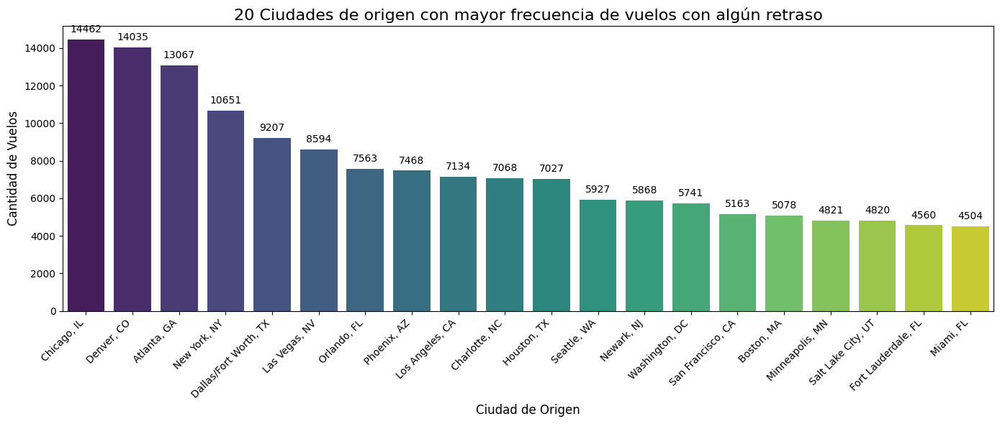

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

# Cuenta las 20 rutas más frecuentes
top_20_ciudad_origen = df_final['ORIGIN_CITY'].value_counts().head(20)

# Crea el gráfico de barras con Seaborn
plt.figure(figsize=(14, 6))
grafico_barras = sns.barplot(x=top_20_ciudad_origen.index, y=top_20_ciudad_origen.values, palette='viridis')
plt.title('20 Ciudades de origen con mayor frecuencia de vuelos con algún retraso', fontsize=16)
plt.xlabel('Ciudad de Origen', fontsize=12)
plt.ylabel('Cantidad de Vuelos', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Añade etiquetas a cada barra
for p in grafico_barras.patches:
    grafico_barras.annotate(f'{int(p.get_height())}',
                           (p.get_x() + p.get_width() / 2., p.get_height()),
                           ha='center', va='bottom', fontsize=10,
                           xytext=(0, 5), textcoords='offset points')

plt.tight_layout()
plt.show()

###**Vuelos con retraso en ciudad de origen**

In [37]:
# Filtra para tener solo los vuelos que tuvieron un retraso de salida
df_retrasos_salida = df_final[df_final['DIC_DEPDELAY'] == 1]

# Analiza la distribución de Ciudad de Origen solo si tuvieron vuelos retrasados
df_retrasos_salida.ORIGIN_CITY.describe()

,ORIGIN_CITY
count,201852
unique,332
top,"Denver, CO"
freq,12415


In [38]:
estadisticas_ordenadas = df_retrasos_salida.groupby('ORIGIN_CITY').describe().DEP_DELAY.sort_values(by='count',ascending=False)
estadisticas_ordenadas

,count,mean,min,25%,50%,75%,max,std
ORIGIN_CITY,,,,,,,,
"Denver, CO",12415.0,37.581313,1.0,7.00,17.0,42.00,1502.0,68.117509
"Chicago, IL",11256.0,38.017768,1.0,6.00,16.0,43.00,2130.0,71.678265
"Atlanta, GA",10746.0,40.029872,1.0,6.00,18.0,45.00,1117.0,74.237451
"New York, NY",8678.0,47.555658,1.0,8.00,23.0,57.00,1201.0,74.495009
"Las Vegas, NV",7263.0,39.498692,1.0,7.00,17.0,44.00,2250.0,82.795516
...,...,...,...,...,...,...,...,...
"Greenville, NC",2.0,184.500000,14.0,99.25,184.5,269.75,355.0,241.123412
"Adak Island, AK",2.0,25.000000,4.0,14.50,25.0,35.50,46.0,29.698485
"Santa Maria, CA",2.0,6.000000,5.0,5.50,6.0,6.50,7.0,1.414214


In [39]:
import plotly.express as px
import pandas as pd

# Filtra para solo los vuelos de las 20 ciudades con + cantidad de vuelos con algún retrasos
top_20_ciudades_lista = estadisticas_ordenadas.head(20).index
df_top_20_ciudades = df_retrasos_salida[df_retrasos_salida['ORIGIN_CITY'].isin(top_20_ciudades_lista)]

# Ordenado
orden_ciudades = top_20_ciudades_lista.tolist()

# Crear el gráfico de bigotes
fig = px.box(
    df_top_20_ciudades,
    x='ORIGIN_CITY',
    y='DEP_DELAY',
    title='Distribución de Retrasos por Ciudad (Top 20)',
    color='ORIGIN_CITY',  # Colorea cada caja de forma diferente
    category_orders={'ORIGIN_CITY': orden_ciudades}, # ¡Parámetro crucial para el orden!
    height=700
)

# Ajustar diseño y mostrar
fig.update_layout(xaxis={'categoryorder': 'array', 'categoryarray': orden_ciudades})
fig.update_xaxes(tickangle=45)
fig.show()

In [40]:
import plotly.express as px
import pandas as pd

# Crea el histograma del retraso en salida
fig = px.histogram(
    df_retrasos_salida,
    x='DEP_DELAY',
    nbins=50,  # El número de 'bins' (barras) es similar al que usaste en sns.histplot
    marginal='box', # Opcional: añade un gráfico de bigotes en la parte superior para ver la distribución
    title='Distribución de los Retrasos de Salida (Solo Vuelos Retrasados)',
    labels={'DEP_DELAY': 'Minutos de Retraso de Salida', 'count': 'Cantidad de Vuelos'},
    color_discrete_sequence=['deepskyblue'],
    height=600
)

# Ajusta el diseño para hacer el gráfico más legible
fig.update_traces(marker_line_width=1, marker_line_color='white')
fig.show()

In [41]:
estadisticas_ordenadas = df_retrasos_salida.groupby('ORIGIN_CITY').describe().DEP_DELAY.sort_values(by='50%',ascending=False)
estadisticas_ordenadas

,count,mean,min,25%,50%,75%,max,std
ORIGIN_CITY,,,,,,,,
"Pocatello, ID",3.0,390.000000,4.0,155.00,306.0,583.00,860.0,434.138227
"Laramie, WY",4.0,380.500000,59.0,89.75,273.5,564.25,916.0,397.167051
"Greenville, NC",2.0,184.500000,14.0,99.25,184.5,269.75,355.0,241.123412
"Stillwater, OK",2.0,150.000000,37.0,93.50,150.0,206.50,263.0,159.806133
"Texarkana, AR",19.0,204.315789,5.0,45.00,103.0,245.50,1441.0,320.867064
...,...,...,...,...,...,...,...,...
"Elko, NV",11.0,19.545455,1.0,5.00,7.0,22.50,74.0,23.217940
"Santa Maria, CA",2.0,6.000000,5.0,5.50,6.0,6.50,7.0,1.414214
"Kotzebue, AK",8.0,7.625000,2.0,2.00,6.0,9.25,24.0,7.405355


In [42]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filtra el DataFrame original para solo los vuelos de las 20 ciudades con vuelos con media de más retrasos
top_20_ciudades_lista = estadisticas_ordenadas.head(20).index
df_top_20_ciudades = df_retrasos_salida[df_retrasos_salida['ORIGIN_CITY'].isin(top_20_ciudades_lista)]

#Ordenar
orden_ciudades = top_20_ciudades_lista.tolist()

# Crear el gráfico de bigotes
fig = px.box(
    df_top_20_ciudades,
    x='ORIGIN_CITY',
    y='DEP_DELAY',
    title='Distribución Dinámica de Retrasos por Ciudad (Top 20)',
    color='ORIGIN_CITY',
    category_orders={'ORIGIN_CITY': orden_ciudades},
    height=700
)

# Ajustar el diseño para rotar las etiquetas y asegurar el orden
fig.update_layout(
    xaxis={'categoryorder': 'array', 'categoryarray': orden_ciudades}, # Refuerza el orden
    xaxis_tickangle=-45
)
fig.show()

##**Variable "Ciudad de destino"**

In [43]:
df_final.DEST_CITY.describe()

,DEST_CITY
count,256522
unique,333
top,"Chicago, IL"
freq,12393


/tmp/ipython-input-2385749713.py:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




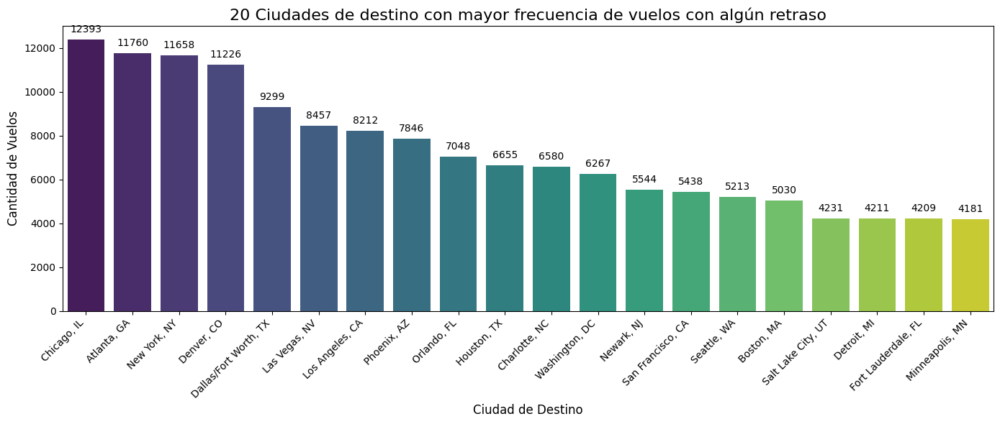

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns

# Cuenta las 20 rutas más frecuentes
top_20_ciudad_destino = df_final['DEST_CITY'].value_counts().head(20)

# Crea el gráfico de barras con Seaborn
plt.figure(figsize=(14, 6))
grafico_barras = sns.barplot(x=top_20_ciudad_destino.index, y=top_20_ciudad_destino.values, palette='viridis')
plt.title('20 Ciudades de destino con mayor frecuencia de vuelos con algún retraso', fontsize=16)
plt.xlabel('Ciudad de Destino', fontsize=12)
plt.ylabel('Cantidad de Vuelos', fontsize=12)
plt.xticks(rotation=45, ha='right')

# Añade etiquetas a cada barra
for p in grafico_barras.patches:
    grafico_barras.annotate(f'{int(p.get_height())}',
                           (p.get_x() + p.get_width() / 2., p.get_height()),
                           ha='center', va='bottom', fontsize=10,
                           xytext=(0, 5), textcoords='offset points')

plt.tight_layout()
plt.show()

###**Vuelos con retraso en ciudad de destino**

In [45]:
# Filtra para tener solo los vuelos que tuvieron un retraso de llegada
df_retrasos_destino = df_final[df_final['DIC_ARRDELAY'] == 1]

# Analiza la distribución de Ciudad de Llegada solo si tuvieron vuelos retrasados
df_retrasos_destino.DEST_CITY.describe()

,DEST_CITY
count,202574
unique,333
top,"New York, NY"
freq,9827


In [46]:
estadisticas_ordenadasnew = df_retrasos_destino.groupby('DEST_CITY').describe().ARR_DELAY.sort_values(by='count',ascending=False)
estadisticas_ordenadasnew

,count,mean,min,25%,50%,75%,max,std
DEST_CITY,,,,,,,,
"New York, NY",9827.0,47.096876,1.0,9.00,22.0,56.00,2557.0,84.888226
"Chicago, IL",9705.0,45.898300,1.0,7.00,20.0,51.00,1467.0,85.540319
"Atlanta, GA",8773.0,49.138379,1.0,8.00,20.0,54.00,1137.0,88.209734
"Denver, CO",8758.0,45.243777,1.0,8.00,19.0,50.00,1394.0,78.995482
"Dallas/Fort Worth, TX",7544.0,51.595308,1.0,7.00,18.0,50.00,2027.0,117.585477
...,...,...,...,...,...,...,...,...
"Santa Maria, CA",2.0,10.500000,7.0,8.75,10.5,12.25,14.0,4.949747
"St. Cloud, MN",2.0,11.000000,3.0,7.00,11.0,15.00,19.0,11.313708
"Greenville, NC",1.0,3.000000,3.0,3.00,3.0,3.00,3.0,NaN


In [47]:
import plotly.express as px
import pandas as pd

# Filtra el DataFrame original para solo los vuelos de las 20 ciudades con + cantidad de vuelos con algún retrasos
top_20_ciudades_destino_lista = estadisticas_ordenadasnew.head(20).index
df_top_20_ciudades_destino = df_retrasos_destino[df_retrasos_destino['DEST_CITY'].isin(top_20_ciudades_destino_lista)]

# Orden
orden_ciudades_destino = top_20_ciudades_destino_lista.tolist()

# Gráfico de bigotes
fig = px.box(
    df_top_20_ciudades_destino,
    x='DEST_CITY',
    y='ARR_DELAY',
    title='Distribución de Retrasos de Llegada por Ciudad (Top 20 Destinos)',
    color='DEST_CITY',  # Colorea cada caja de forma diferente
    category_orders={'DEST_CITY': orden_ciudades_destino}, # Parámetro CRUCIAL para mantener el orden
    height=700
)

# Ajustar el diseño y mostrar
fig.update_layout(
    xaxis={'categoryorder': 'array', 'categoryarray': orden_ciudades_destino}, # Refuerza el orden
    xaxis_tickangle=-45 # Rota las etiquetas del eje X
)
fig.show()

In [48]:
import plotly.express as px
import pandas as pd

# Crea el histograma de los retrasos de llegada reales
fig = px.histogram(
    df_retrasos_destino,
    x='ARR_DELAY',
    nbins=50,  # Mantiene 50 barras para una buena resolución
    marginal='box', # Añade un box plot en la parte superior para ver la mediana y cuartiles
    title='Distribución de los Retrasos de Llegada (Solo Vuelos Retrasados)',
    labels={'ARR_DELAY': 'Minutos de Retraso de Llegada', 'count': 'Cantidad de Vuelos'},
    color_discrete_sequence=['deepskyblue'],
    height=600
)

# Ajusta el diseño para hacer el gráfico más legible
fig.update_traces(marker_line_width=1, marker_line_color='white')
fig.show()

In [49]:
estadisticas_ordenadasnew = df_retrasos_destino.groupby('DEST_CITY').describe().ARR_DELAY.sort_values(by='50%',ascending=False)
estadisticas_ordenadasnew

,count,mean,min,25%,50%,75%,max,std
DEST_CITY,,,,,,,,
"Meridian, MS",15.0,108.066667,1.0,10.50,56.0,102.00,830.0,205.279763
"Vernal, UT",15.0,71.466667,3.0,6.00,48.0,135.00,186.0,68.288115
"Brunswick, GA",13.0,66.076923,2.0,4.00,43.0,77.00,317.0,85.371211
"Sioux City, IA",21.0,76.476190,1.0,13.00,41.0,82.00,702.0,147.316536
"Hattiesburg/Laurel, MS",9.0,131.333333,1.0,26.00,41.0,82.00,838.0,267.073024
...,...,...,...,...,...,...,...,...
"Hagerstown, MD",5.0,39.600000,5.0,6.00,7.0,15.00,165.0,70.212534
"Adak Island, AK",1.0,5.000000,5.0,5.00,5.0,5.00,5.0,NaN
"Jacksonville/Camp Lejeune, NC",20.0,17.200000,1.0,2.75,4.5,23.25,102.0,24.650398


In [50]:
import matplotlib.pyplot as plt
import seaborn as sns

# Filtra el DataFrame original para solo los vuelos de las 20 ciudades con vuelos con media de más retrasos
top_20_ciudades_destino_lista = estadisticas_ordenadasnew.head(20).index
df_top_20_ciudades_destino = df_retrasos_destino[df_retrasos_destino['DEST_CITY'].isin(top_20_ciudades_destino_lista)]

#Ordenar
orden_ciudades = top_20_ciudades_destino_lista.tolist()

# Crear el gráfico de bigotes
fig = px.box(
    df_top_20_ciudades_destino,
    x='DEST_CITY',
    y='ARR_DELAY',
    title='Distribución de Retrasos en llegada por Ciudad (Top 20)',
    color='DEST_CITY',
    category_orders={'DEST_CITY': orden_ciudades},
    height=700
)

# Ajustar el diseño para rotar las etiquetas y asegurar el orden
fig.update_layout(
    xaxis={'categoryorder': 'array', 'categoryarray': orden_ciudades}, # Refuerza el orden
    xaxis_tickangle=-45
)
fig.show()

#**Correlaciones**

##**Tiempo de retraso en el origen y el destino**

In [51]:
# Calcula la correlación entre DEP_DELAY y ARR_DELAY
correlacion = df_final['DEP_DELAY'].corr(df_final['ARR_DELAY'])

# Muestra el resultado
print(f"La correlación entre el retraso en la salida y el retraso en la llegada es: {correlacion:.2f}")

La correlación entre el retraso en la salida y el retraso en la llegada es: 0.97


In [52]:
import plotly.express as px
import pandas as pd

# Crea el gráfico de dispersión
fig = px.scatter(
    df_final,
    x='DEP_DELAY',
    y='ARR_DELAY',
    title=f'Correlación Dinámica entre Retraso de Salida y Retraso de Llegada',
    labels={'DEP_DELAY': 'Retraso de Salida (minutos)', 'ARR_DELAY': 'Retraso de Llegada (minutos)'},
    opacity=0.5, # Hace los puntos ligeramente transparentes para ver la densidad en áreas superpuestas
    trendline='ols', # Añade la línea de regresión (mínimos cuadrados ordinarios)
    render_mode='auto', # Optimiza el renderizado de la gráfica para grandes datasets
    height=650
)

# Ajusta el tamaño de los marcadores
fig.update_traces(marker_size=5)

fig.show()

##**Tiempo de retraso en el origen y tiempo en causa de demora**

In [53]:
# Identificar los vuelos que sí tuvieron demora.
df_retrasos_salida = df_final[df_final['DIC_DEPDELAY'] == 1].copy()

#Define las columnas de las causas de retraso
columnas_causa_retraso = ['DELAY_DUE_CARRIER', 'DELAY_DUE_WEATHER', 'DELAY_DUE_NAS', 'DELAY_DUE_SECURITY', 'DELAY_DUE_LATE_AIRCRAFT']

# Calcula la correlación de DEP_DELAY con cada columna de causa de retraso
correlacion_causas_general = df_retrasos_salida[columnas_causa_retraso].corrwith(df_retrasos_salida['DEP_DELAY'])

# Muestra los resultados ordenados de mayor a menor correlación
print("Correlación de cada causa con el retraso total de salida (General):")
print(correlacion_causas_general.sort_values(ascending=False))

Correlación de cada causa con el retraso total de salida (General):
DELAY_DUE_CARRIER          0.692840
DELAY_DUE_LATE_AIRCRAFT    0.558657
DELAY_DUE_WEATHER          0.331583
DELAY_DUE_NAS              0.233667
DELAY_DUE_SECURITY         0.014603
dtype: float64


##**Tiempo de retraso en el destino y tiempo en causa de demora**

In [54]:
# Identificar vuelos que sí tuvieron demora al aterrizar
df_retrasos_destino = df_final[df_final['DIC_ARRDELAY'] == 1].copy()

# Define las columnas de las causas de retraso
columnas_causa_retraso = ['DELAY_DUE_CARRIER', 'DELAY_DUE_WEATHER', 'DELAY_DUE_NAS', 'DELAY_DUE_SECURITY', 'DELAY_DUE_LATE_AIRCRAFT']

# Calcula la correlación de ARR_DELAY con cada columna de causa de retraso
correlacion_causas_destino = df_retrasos_destino[columnas_causa_retraso].corrwith(df_retrasos_destino['ARR_DELAY'])

# Muestra los resultados ordenados de mayor a menor correlación
print("Correlación de cada causa con el retraso total de llegada (General):")
print(correlacion_causas_destino.sort_values(ascending=False))

Correlación de cada causa con el retraso total de llegada (General):
DELAY_DUE_CARRIER          0.688717
DELAY_DUE_LATE_AIRCRAFT    0.545178
DELAY_DUE_WEATHER          0.345084
DELAY_DUE_NAS              0.277869
DELAY_DUE_SECURITY         0.014392
dtype: float64


#**Variable aerolineas con retraso en ciudad de origen**




In [55]:
import pandas as pd

# Aseguramos que solo trabajamos con vuelos que tuvieron retraso de salida
df_retrasos_salida = df_final[df_final['DIC_DEPDELAY'] == 1].copy()

# Cuenta la cantidad de vuelos retrasados por aerolínea
frecuencia_retrasos_por_aerolinea = df_retrasos_salida['Description_aerolinea'].value_counts()

print("Aerolíneas con la mayor cantidad de vuelos con retraso en ciudad de origen:")
print(frecuencia_retrasos_por_aerolinea)

Aerolíneas con la mayor cantidad de vuelos con retraso en ciudad de origen:
Description_aerolinea
Southwest Airlines Co.    51735
Delta Air Lines Inc.      28158
American Airlines Inc.    25977
United Air Lines Inc.     23179
SkyWest Airlines Inc.     15242
Spirit Air Lines           9582
JetBlue Airways            9294
Alaska Airlines Inc.       6894
Frontier Airlines Inc.     6695
Envoy Air                  5830
Republic Airline           4860
Endeavor Air Inc.          4713
Allegiant Air              3392
PSA Airlines Inc.          3251
Hawaiian Airlines Inc.     3050
Name: count, dtype: int64


In [56]:
import plotly.express as px

df_frecuencia= frecuencia_retrasos_por_aerolinea.reset_index()
df_frecuencia.columns = ['Aerolinea', 'Cantidad_Retrasos']

# Crea el gráfico circular
fig_pie = px.pie(
    df_frecuencia,
    names='Aerolinea',
    values='Cantidad_Retrasos',
    title='Proporción de Vuelos Retrasados en ciudad de origen por Aerolínea',
    hole=.3,
    height=600
)

# Ajustes de texto
fig_pie.update_traces(textposition='inside', textinfo='percent+label')
fig_pie.show()

In [57]:
import pandas as pd
import plotly.express as px

df_retrasos_salida = df_final[df_final['DIC_DEPDELAY'] == 1].copy()

df_retrasos_filtrados = df_retrasos_salida[
    (df_retrasos_salida['DELAY_DUE_CARRIER'] > 0) |
    (df_retrasos_salida['DELAY_DUE_LATE_AIRCRAFT'] > 0)
].copy()

## Calcular la mediana
retraso_mediano_filtrado = df_retrasos_filtrados.groupby('Description_aerolinea')['DEP_DELAY'].median()
peores_aerolineas_por_mediana = retraso_mediano_filtrado.sort_values(ascending=False)

# lista de aerolíneas con el peor retraso mediano
top_15_aerolineas_lista = peores_aerolineas_por_mediana.head(15).index.tolist()

# Filtro
df_top_15 = df_retrasos_filtrados[df_retrasos_filtrados['Description_aerolinea'].isin(top_15_aerolineas_lista)]

## Crear el Gráfico de bigotes
fig = px.box(
    df_top_15,
    x='Description_aerolinea',
    y='DEP_DELAY',
    title='Distribución de Retrasos de Salida (Solo Causas CARRIER/AIRCRAFT) - Top 15 Aerolíneas',
    color='Description_aerolinea',  # Colorea cada caja
    category_orders={'Description_aerolinea': top_15_aerolineas_lista}, # Mantiene el orden de peor a mejor mediana
    height=700
)

# Ajustes visuales
fig.update_layout(
    xaxis_tickangle=-45,
    xaxis_title='Aerolínea',
    yaxis_title='Retraso de Salida (minutos)'
)
fig.show()

### **Caso Chicago, IL**

In [58]:
import pandas as pd

ciudad_objetivo = 'Chicago, IL'

df_retrasos_chicago = df_final[
    (df_final['ORIGIN_CITY'] == ciudad_objetivo) &
    (df_final['DIC_DEPDELAY'] == 1)
].copy()

# Cuenta la cantidad de vuelos retrasados para cada aerolínea
conteo_retrasos_chicago = df_retrasos_chicago['Description_aerolinea'].value_counts()

print(f"Cantidad de Vuelos Retrasados por Aerolínea con origen a {ciudad_objetivo} (Ordenado por Frecuencia):")
print(conteo_retrasos_chicago)

Cantidad de Vuelos Retrasados por Aerolínea con origen a Chicago, IL (Ordenado por Frecuencia):
Description_aerolinea
Southwest Airlines Co.    3358
United Air Lines Inc.     2440
American Airlines Inc.    1797
Envoy Air                 1202
SkyWest Airlines Inc.      961
Delta Air Lines Inc.       398
Spirit Air Lines           392
Republic Airline           320
Frontier Airlines Inc.     214
Alaska Airlines Inc.        83
Endeavor Air Inc.           51
JetBlue Airways             28
Allegiant Air               12
Name: count, dtype: int64


In [59]:
import pandas as pd
import plotly.express as px

df_retrasos_salida = df_final[df_final['DIC_DEPDELAY'] == 1].copy()

# FILTRO POR CIUDAD DE ORIGEN (Chicago, IL)
ciudad_origen_filtro = 'Chicago, IL'
df_retrasos_chicago = df_retrasos_salida[df_retrasos_salida['ORIGIN_CITY'] == ciudad_origen_filtro].copy()

df_retrasos_filtrados = df_retrasos_chicago[
    (df_retrasos_chicago['DELAY_DUE_CARRIER'] > 0) |
    (df_retrasos_chicago['DELAY_DUE_LATE_AIRCRAFT'] > 0)
].copy()

# Calcular mediana del retraso de salida SÓLO para los vuelos de Chicago
retraso_mediano_filtrado = df_retrasos_filtrados.groupby('Description_aerolinea')['DEP_DELAY'].median()
peores_aerolineas_por_mediana = retraso_mediano_filtrado.sort_values(ascending=False)

# lista de aerolíneas con el peor retraso
top_15_aerolineas_lista = peores_aerolineas_por_mediana.head(15).index.tolist()

# Filtro final
df_top_15 = df_retrasos_filtrados[df_retrasos_filtrados['Description_aerolinea'].isin(top_15_aerolineas_lista)]

# Crear el gráfico de bigotes
fig = px.box(
    df_top_15,
    x='Description_aerolinea',
    y='DEP_DELAY',
    # Título actualizado para reflejar el filtro de ciudad
    title=f'Distribución de Retrasos de Salida desde {ciudad_origen_filtro} (Causas CARRIER/AIRCRAFT) - Top 15 Aerolíneas',
    color='Description_aerolinea',  # Colorea cada caja
    category_orders={'Description_aerolinea': top_15_aerolineas_lista}, # Mantiene el orden de peor a mejor mediana
    height=700
)

# Ajustes visuales
fig.update_layout(
    xaxis_tickangle=-45,
    xaxis_title='Aerolínea',
    yaxis_title='Retraso de Salida (minutos)'
)
fig.show()

#**Variable aerolineas con retraso en ciudad de destino**

In [60]:
df_retrasos_llegada = df_final[df_final['DIC_ARRDELAY'] == 1].copy()

# Cuenta la cantidad de vuelos retrasados por aerolínea
frecuencia_retrasos_por_aerolinea = df_retrasos_llegada['Description_aerolinea'].value_counts()

print("Aerolíneas con la mayor cantidad de vuelos con retraso en ciudad de destino:")
print(frecuencia_retrasos_por_aerolinea)

Aerolíneas con la mayor cantidad de vuelos con retraso en ciudad de destino:
Description_aerolinea
Southwest Airlines Co.    40279
American Airlines Inc.    29390
Delta Air Lines Inc.      26647
United Air Lines Inc.     21920
SkyWest Airlines Inc.     19391
Spirit Air Lines           9715
JetBlue Airways            9322
Alaska Airlines Inc.       7701
Envoy Air                  7528
Republic Airline           6902
Frontier Airlines Inc.     6590
Endeavor Air Inc.          5743
PSA Airlines Inc.          4280
Allegiant Air              3762
Hawaiian Airlines Inc.     3404
Name: count, dtype: int64


In [61]:
import plotly.express as px

df_frecuencia= frecuencia_retrasos_por_aerolinea.reset_index()
df_frecuencia.columns = ['Aerolinea', 'Cantidad_Retrasos']

# Crea el gráfico circular
fig_pie = px.pie(
    df_frecuencia,
    names='Aerolinea',
    values='Cantidad_Retrasos',
    title='Proporción de Vuelos Retrasados en ciudad de destino por Aerolínea',
    hole=.3,
    height=600
)

# Ajustes de texto
fig_pie.update_traces(textposition='inside', textinfo='percent+label')
fig_pie.show()

In [62]:
import pandas as pd
import plotly.express as px

df_retrasos_llegada = df_final[df_final['DIC_ARRDELAY'] == 1].copy()

df_retrasos_filtrados = df_retrasos_llegada[
    (df_retrasos_llegada['DELAY_DUE_CARRIER'] > 0) |
    (df_retrasos_llegada['DELAY_DUE_LATE_AIRCRAFT'] > 0)
].copy()

## Calcular la mediana
retraso_mediano_filtrado = df_retrasos_filtrados.groupby('Description_aerolinea')['DEP_DELAY'].median()
peores_aerolineas_por_mediana = retraso_mediano_filtrado.sort_values(ascending=False)

# lista de aerolíneas con el peor retraso mediano
top_15_aerolineas_lista = peores_aerolineas_por_mediana.head(15).index.tolist()

# Filtro
df_top_15 = df_retrasos_filtrados[df_retrasos_filtrados['Description_aerolinea'].isin(top_15_aerolineas_lista)]

## Crear el Gráfico de bigotes
fig = px.box(
    df_top_15,
    x='Description_aerolinea',
    y='DEP_DELAY',
    title='Distribución de Retrasos de Llegada (Solo Causas CARRIER/AIRCRAFT) - Top 15 Aerolíneas',
    color='Description_aerolinea',
    category_orders={'Description_aerolinea': top_15_aerolineas_lista},
    height=700
)

# Ajustes visuales
fig.update_layout(
    xaxis_tickangle=-45,
    xaxis_title='Aerolínea',
    yaxis_title='Retraso de Salida (minutos)'
)
fig.show()

In [63]:
import pandas as pd

ciudad_objetivo = 'Chicago, IL'

df_retrasos_chicago = df_final[
    (df_final['DEST_CITY'] == ciudad_objetivo) &
    (df_final['DIC_ARRDELAY'] == 1)
].copy()

# Cuenta la cantidad de vuelos retrasados para cada aerolínea
conteo_retrasos_chicago = df_retrasos_chicago['Description_aerolinea'].value_counts()

print(f"Cantidad de Vuelos Retrasados por Aerolínea con Destino a {ciudad_objetivo} (Ordenado por Frecuencia):")
print(conteo_retrasos_chicago)

Cantidad de Vuelos Retrasados por Aerolínea con Destino a Chicago, IL (Ordenado por Frecuencia):
Description_aerolinea
Southwest Airlines Co.    2142
United Air Lines Inc.     2122
Envoy Air                 1476
American Airlines Inc.    1387
SkyWest Airlines Inc.     1048
Delta Air Lines Inc.       413
Republic Airline           380
Spirit Air Lines           343
Frontier Airlines Inc.     195
Alaska Airlines Inc.        92
Endeavor Air Inc.           63
JetBlue Airways             34
Allegiant Air               10
Name: count, dtype: int64


#**Conclusiones y Recomendaciones**



**1. Ciudades pequeñas con retrasos largos**

En aeropuertos con pocos vuelos (Pocatello, Laramie, Greenville, Stillwater), revisar la asignación de recursos logísticos.

**2. Fuerte relación entre el tiempo de demora en cada ciudad de origen/destino y el retraso causado por la aerolínea**

Priorizar el análisis por aerolínea más que por aeropuerto, dado que los retrasos se replican en cadena (un avión atrasado en origen arrastra retraso al destino).

En esta linea, se suguire evaluar con más detalle las operaciones de las aerolineas con mayor cantidad de retrasos para identificar oportunidades de mejora.



